# Create Exoplanet models

In [1]:
import os, sys
sys.path.insert(1, '/Users/azib/Documents/open_source/nets2/stella/')
sys.path.insert(1, '/Users/azib/Documents/open_source/nets2/scripts/')
import numpy as np
from utils import *
import build_synthetic_set as models
import matplotlib.pyplot as plt
from astropy.table import Table
from glob import glob
from tqdm import tqdm
import wotan
import lightkurve as lk
import stella
import pandas as pd
import random
import batman
import warnings
from astroquery.mast import Catalogs
import astropy.constants as const
import time
import re
import pickle

/Users/azib/micromamba/envs/nets2/lib/python3.8/site-packages/lightkurve/config/__init__.py:119: UserWarning: The default Lightkurve cache directory, used by download(), etc., has been moved to /Users/azib/.lightkurve/cache. Please move all the files in the legacy directory /Users/azib/.lightkurve-cache to the new location and remove the legacy directory. Refer to https://docs.lightkurve.org/reference/config.html#default-cache-directory-migration for more information.
  warnings.warn(


In [2]:
files = glob('../s0007/*.fits', recursive=True)
random.shuffle(files)

In [3]:
folder = '../exoplanet-models/'
folder2 = '../batman/'

### Load the star

In [4]:
target_IDs = [int(re.search(r"(\d{16})", filename).group(1).lstrip('0')) for filename in files]

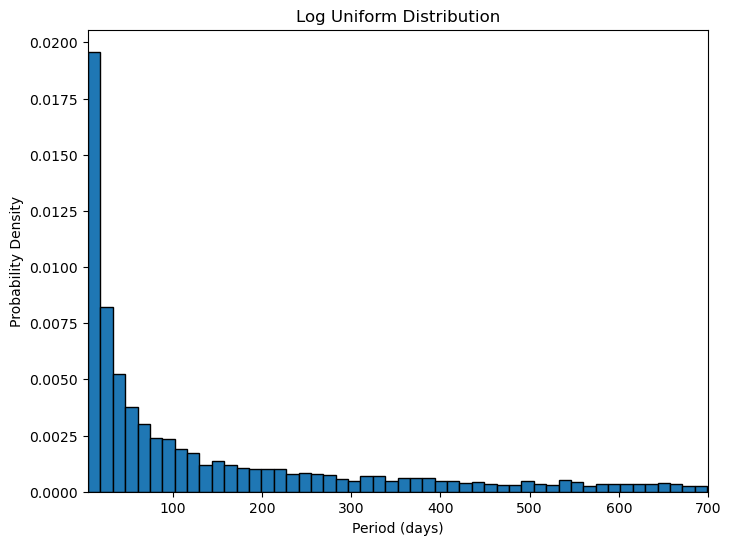

In [17]:
# Define the minimum and maximum periods
period_min = 5
period_max = 700.0

# Generate random values from a uniform distribution between log10(period_min) and log10(period_max)
num_planets = 5000  # Larger number for better visualization
log_periods = np.random.uniform(np.log10(period_min), np.log10(period_max), size=num_planets)

# Convert the log-scale values back to linear scale
periods = 10 ** log_periods

# Plot the histogram
plt.figure(figsize=(8, 6))
plt.hist(periods, bins=50, density=True, edgecolor='black')
plt.xlabel('Period (days)')
plt.ylabel('Probability Density')
plt.title('Log Uniform Distribution')
plt.xlim(period_min, period_max)
plt.savefig('log-dist.png',dpi=200)
plt.show()

In [6]:
np.random.shuffle(target_IDs)

# Convert the log-scale values back to linear scale
num_planets = 1
max_retries = 5
retry_delay = 1
alpha = 1.5
timeout_duration = 5

TIC_table = Catalogs.query_object(f'TIC 270577175', catalog="TIC")
r_star = TIC_table['rad'][0]
m_star = TIC_table['mass'][0]

os.makedirs(folder, exist_ok=True)
os.makedirs(folder2,exist_ok=True)

In [7]:
dp = {}

for target_ID in tqdm(target_IDs[0:300]):
    lctest = lk.search_lightcurve(f'TIC {target_ID}', author='GSFC-ELEANOR-LITE', sector=7)[0].download()
    #lctest = lctest[lctest.quality == 0]
    
    dp[target_ID] = lctest

100%|██████| 300/300 [12:29<00:00,  2.50s/it]


In [8]:
times = []
ticid = []
injected_lcs = []
limbs = []

for target_ID in tqdm(dp.keys()):  # Iterate through each target ID in the dictionary keys
    lctest = dp[target_ID]


    diff = np.diff(lctest.time.value)
    large_gaps_indices = np.where(diff > 1)[0]

    
    for i in np.arange(0,num_planets):
        #lc, lc_info = import_lightcurve(i)
        retries = 0
    
        flat_flux = wotan.flatten(lctest.time.value,lctest.pca_flux.value,method='median',window_length=1)
        rms = np.nanstd(flat_flux)
    
        min_snr = 3
        max_snr = 20
        random_snr = np.random.uniform(min_snr,max_snr)
        
        A = rms * random_snr
        period = np.random.choice(periods)
        
        while retries < max_retries:
            try:
                params = batman.TransitParams()
                params.per = period
                # Initialize a flag to indicate whether a valid time has been found
                valid_time_found = False
    
                start_time = time.time()
                iteration = 0
                while not valid_time_found and iteration < 10:
                    params.t0 = lctest.time.value[0] + random.uniform(0.0, random.uniform(0.0, params.per))
    
                    for index in large_gaps_indices:
                        start_time = lctest.time.value[index] - 1
                        end_time = lctest.time.value[index + 1] + 1
                        
                        if start_time <= params.t0 <= end_time:
                            break
                        elif index < len(lctest.time.value) - 1 and diff[index] > 0.5 and abs(params.t0 - lctest.time.value[index + 1]) < 1.5:
                            break
                        elif index > 0 and diff[index - 1] > 2 and abs(params.t0 - lctest.time.value[index]) < 1.5:
                            break
                        elif params.t0 <= lctest.time.value[0] + 1:
                            break
                        elif params.t0 >= lctest.time.value[-1] - 1.5:
                            break
                    else:
                        valid_time_found = True
                    iteration += 1
                params.rp = np.sqrt(A) 
                
                params.a = (((const.G.value * m_star * const.M_sun.value * (params.per * 86400.) ** 2) / (4. * (np.pi ** 2))) ** (1. / 3)) / (r_star * const.R_sun.value)
                params.inc = 90 #np.random.uniform(88.0,90.0)

                ## considering inclination using impact parameter
                # b = np.random.uniform(0, 1)
                
                # # Calculate the inclination angle (i) from the impact parameter
                # params.inc = np.arccos(b / (params.a * (1 + params.rp))) * 180 / np.pi
                
                params.ecc = 0.
                params.w = 90.       
    
    
    
                params.limb_dark = "linear"
    
                ld_coeff = np.random.uniform(0,1)
                params.u = [ld_coeff]
                t = lctest.time.value
                m = batman.TransitModel(params, t,fac = 0.02)
    
                #limbs.append(binary)
    
                batman_flux = m.light_curve(params)[:len(t)]
    
                # Check if the minimum value of batman_flux is 1 (flat line)
                if np.min(batman_flux) == 1:
                    retries += 1
                    if retries == max_retries:
                        print(f"Maximum retries ({max_retries}) reached for planet {i + 1}. Skipping this planet.")
                    else:
                        #print(f"Flat line generated for planet {i + 1}, retrying in {retry_delay} seconds... (Retry {retries}/{max_retries})")
                        time.sleep(retry_delay)
                    continue  # Skip the rest of the loop and try again
    
                break  # Break out of the retry loop if the code executes successfully
            except Exception as e:
                if "Convergence failure in calculation of scale factor for integration step size" in str(e):
                    retries += 1
                    if retries == max_retries:
                        print(f"Maximum retries ({max_retries}) reached for planet {i + 1}. Skipping this planet.")
                    else:
                        #print(f"Convergence failure for planet {i + 1}, retrying in {retry_delay} seconds... (Retry {retries}/{max_retries})")
                        time.sleep(retry_delay)
                else:
                    raise e
    
            elapsed_time = time.time() - start_time
            if elapsed_time > timeout_duration:
                print(f"Timeout reached for planet {i + 1}. Skipping this planet.")
                break
        
        ## inject the snr
        
        injected_flux = batman_flux * (lctest.pca_flux.value/np.nanmedian(lctest.pca_flux.value))
        #injected = inject_planet(batman_flux, random_snr)
        #injected_lc = (lc.flux.value / np.nanmedian(lc.flux.value)) * injected
    
        fluxerror = np.array(lctest.raw_flux_err.value)/np.nanmedian(lctest.pca_flux.value)
            
        t = np.array(lctest.time.value)
        flux = np.array(injected_flux)
    
        times.append(params.t0)
        ticid.append(target_ID)
        
        # fig,ax = plt.subplots(1,2,figsize=(10,4))
        # min_idx = np.argmin(batman_flux)
        # ax[0].plot(lctest.time.value[min_idx-84:min_idx+84], batman_flux[min_idx-84:min_idx+84])
        # # ax[1].plot(t,flux)
        # plt.show()
        filename = f"{folder}/{target_ID}_sector06-exoplanet_{i+1}.npy"
        model_filename = f"{folder2}/{target_ID}.npy"
        np.save(model_filename, [t, batman_flux])
        np.save(filename, [t, flux, fluxerror])
    

100%|██████| 300/300 [00:10<00:00, 28.45it/s]


to inject "random SNR" for exoplanets eg 5 sigma (this is the random number)

- flux - 1
- 5/0.0008 (which is the transit depth)
- Then add 1 again

Want high SNR (eg 10 as a start)

In [9]:
data = pd.DataFrame(data=[ticid,times]).T
data.columns = ['TIC','tpeak']
data.TIC = data.TIC.astype(int)
t = Table.from_pandas(data)

t.write('catalog-exoplanets.txt', format='ascii', overwrite=True) 

In [11]:
ds = stella.FlareDataSet(fn_dir='/Users/azib/Documents/open_source/nets2/exoplanet-models/',
                         catalog='/Users/azib/Documents/open_source/nets2/notebooks/catalog-exoplanets.txt',cadences=168,training=0.8)

Reading in training set files.


100%|██| 2003/2003 [00:00<00:00, 2439.84it/s]

198 positive classes (flare)
3116 negative classes (no flare)
6.0% class imbalance



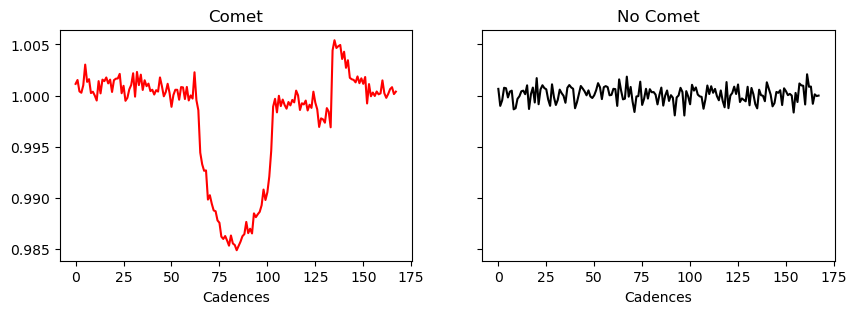

In [12]:
ind_pc = np.where(ds.train_labels==1)[0] # Flares
ind_nc = np.where(ds.train_labels==0)[0] # No flares

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10,3),
                               sharex=True, sharey=True)
ax1.plot(ds.train_data[ind_pc[0]], 'r')
ax1.set_title('Comet')
ax1.set_xlabel('Cadences')
ax2.plot(ds.train_data[ind_nc[5]], 'k')
ax2.set_title('No Comet')
ax2.set_xlabel('Cadences');

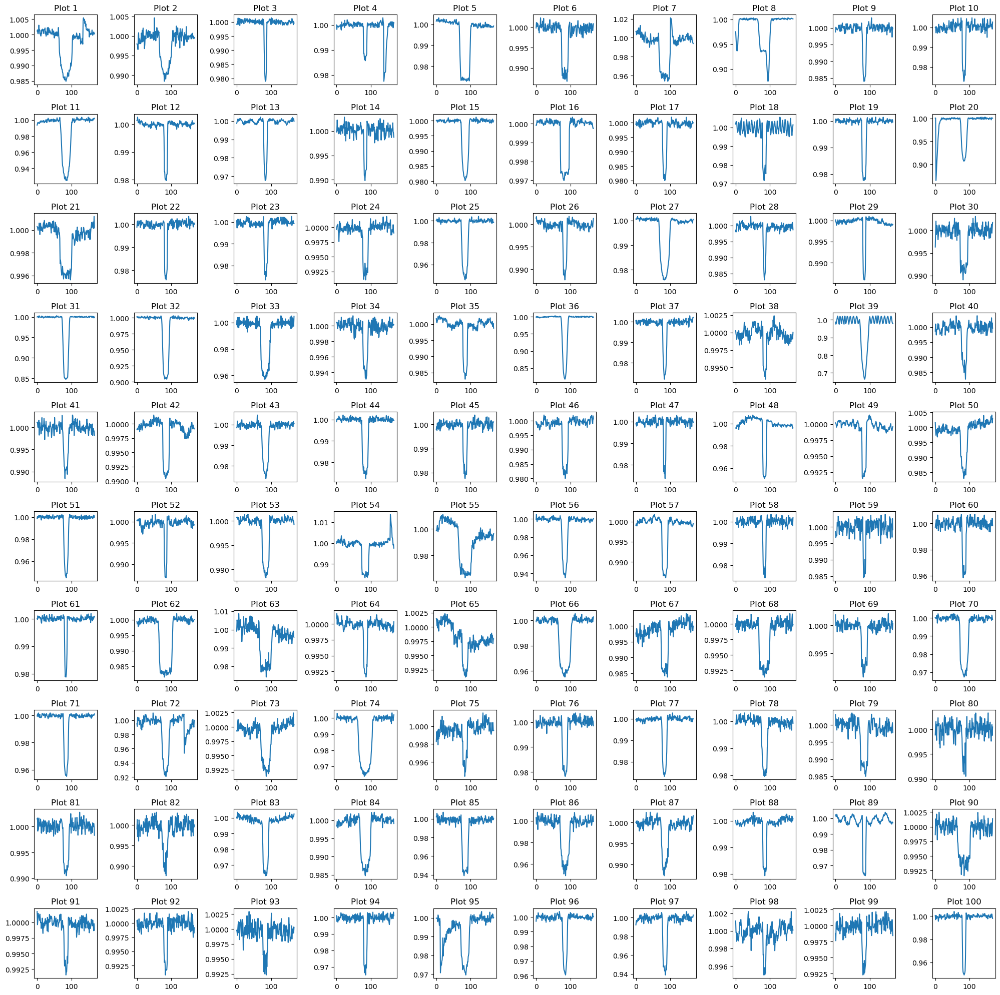

In [13]:
dsmodels = ds.train_data[ind_pc]
num_sets = dsmodels.shape[0] // 100

for set_index in range(num_sets):
    start_index = set_index * 100
    end_index = min((set_index + 1) * 100, dsmodels.shape[0])  # Ensure not to exceed the length of the data

    # Create a new 10x10 grid of subplots for each set
    fig, axs = plt.subplots(10, 10, figsize=(20, 20))

    # Flatten the axes array for easier iteration
    axs = axs.flatten()

    # Iterate over the elements in the current set and plot each in the grid
    for i in range(start_index, end_index):
        plot_index = i % 100  # Calculate the index within the current grid
        axs[plot_index].plot(dsmodels[i, :, 0])  # Assuming you want to plot the first dimension of your array
        axs[plot_index].set_title(f"Plot {i+1}")  # Title for each subplot

    # Hide any remaining empty subplots
    for j in range(end_index - start_index, len(axs)):
        axs[j].axis('off')

    
    plt.tight_layout()  # Adjust layout
    plt.savefig('exoplanet-models.png',dpi=200)
    plt.show()  # Show the grid of plots
    break

---

## Combine

In [6]:
ds2 = stella.FlareDataSet(fn_dir='/Users/azib/Documents/open_source/nets2/eleanor-lite-models/',
                         catalog='/Users/azib/Documents/open_source/nets2/notebooks/catalog-eleanor-lite.txt',cadences=168,training=0.8,merge_datasets=True,other_datasets=ds)

Reading in training set files.


100%|█| 1000/1000 [00:00<00:00, 2424.35it/s

914 positive classes (flare)
794 negative classes (no flare)
115.0% class imbalance



In [24]:
ds2.reformat_data

<bound method FlareDataSet.reformat_data of <stella.preprocessing_flares.FlareDataSet object at 0x30dec4dc0>>

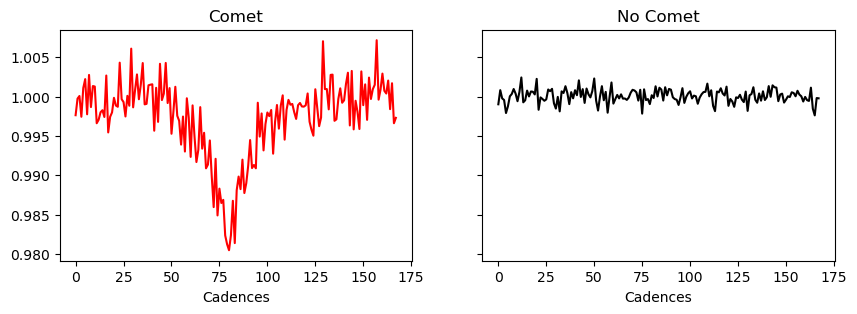

In [10]:
ind_pc = np.where(ds2.train_labels==1)[0] # Flares
ind_nc = np.where(ds2.train_labels==0)[0] # No flares

fig, (ax1, ax2) = plt.subplots(ncols=2, figsize=(10,3),
                               sharex=True, sharey=True)
ax1.plot(ds2.train_data[ind_pc[0]], 'r')
ax1.set_title('Comet')
ax1.set_xlabel('Cadences')
ax2.plot(ds2.train_data[ind_nc[800]], 'k')
ax2.set_title('No Comet')
ax2.set_xlabel('Cadences');

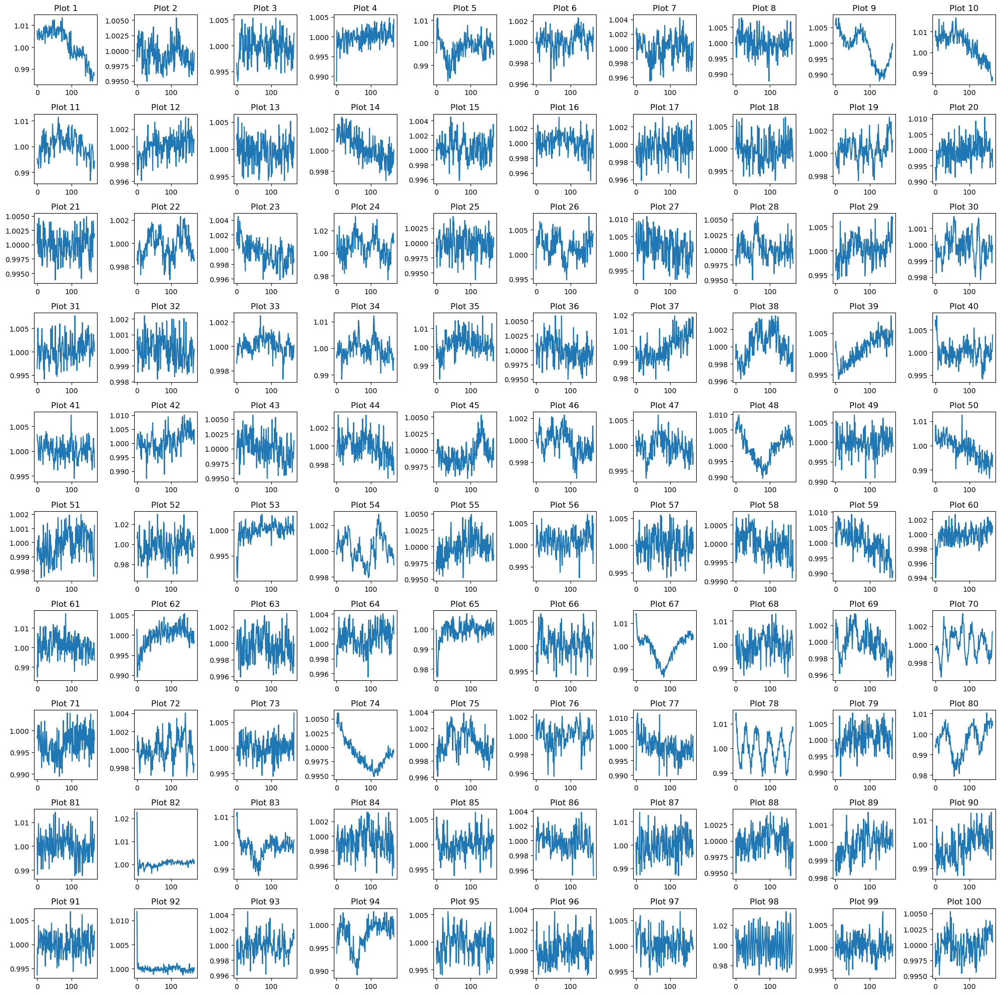

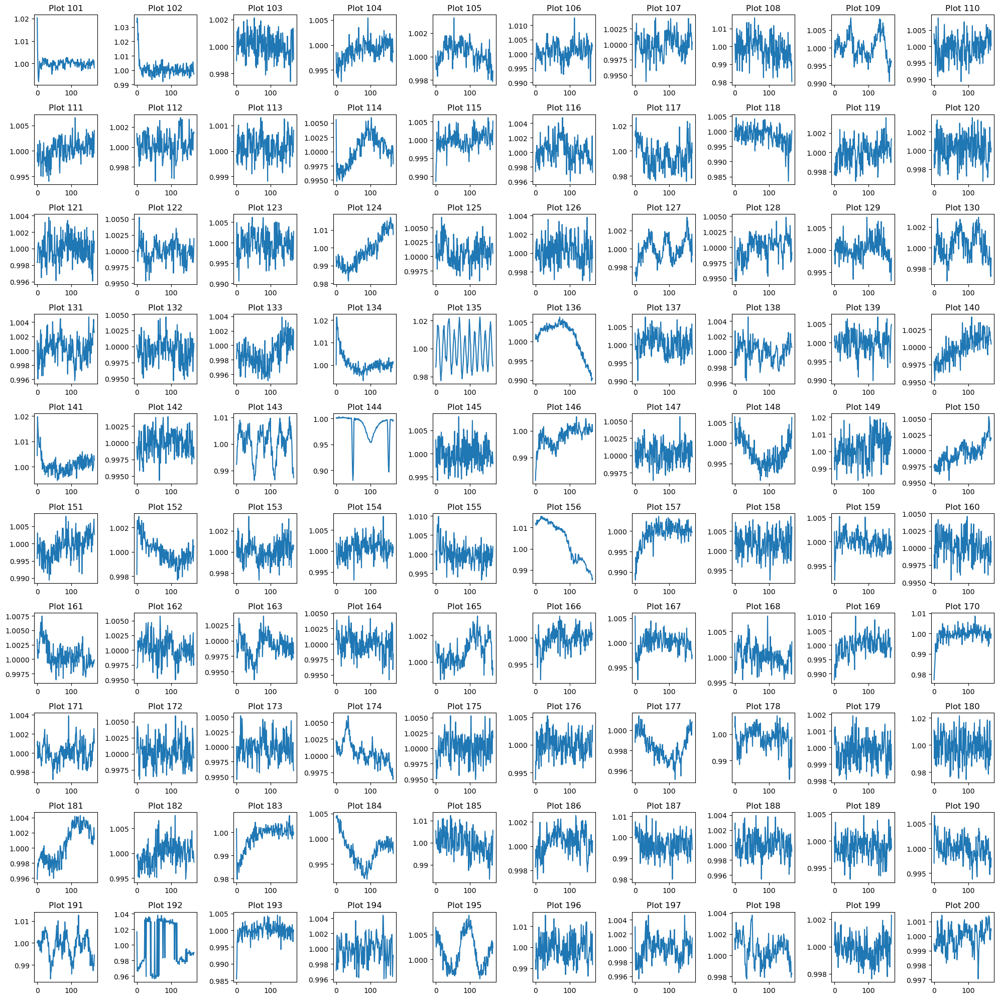

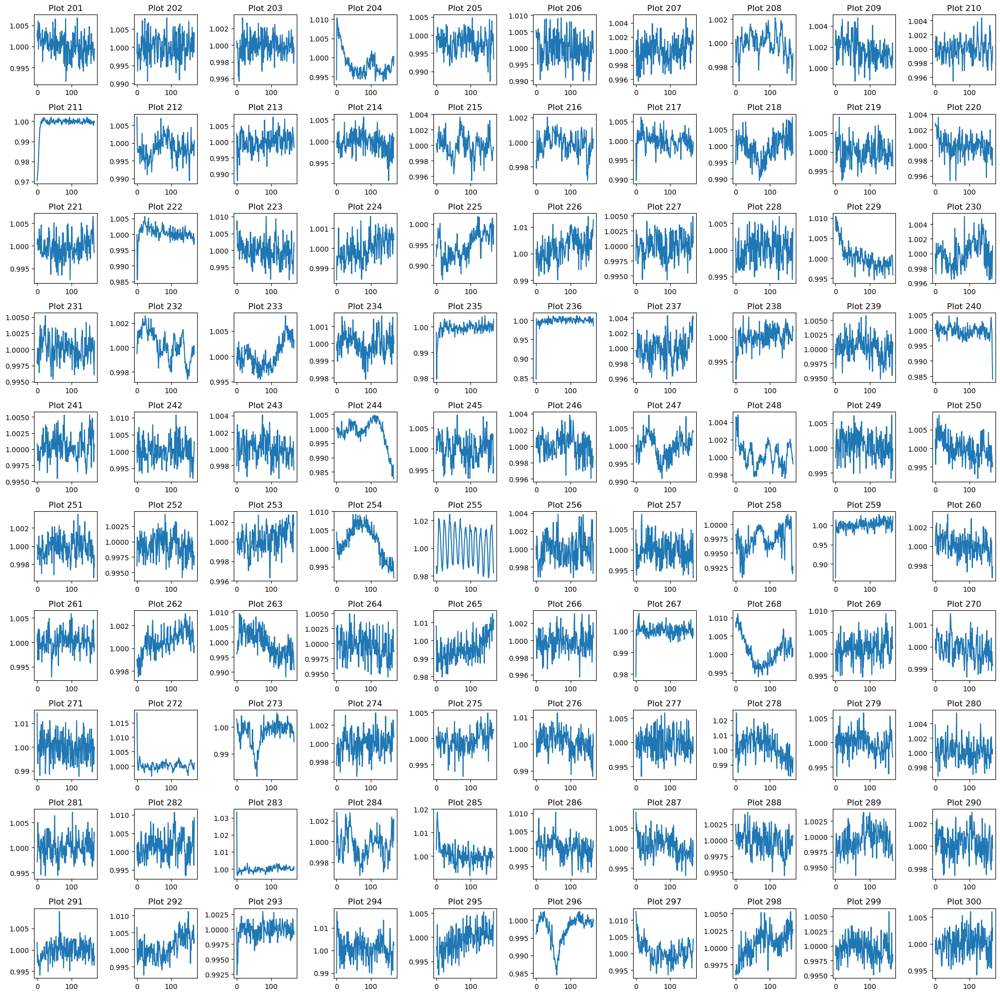

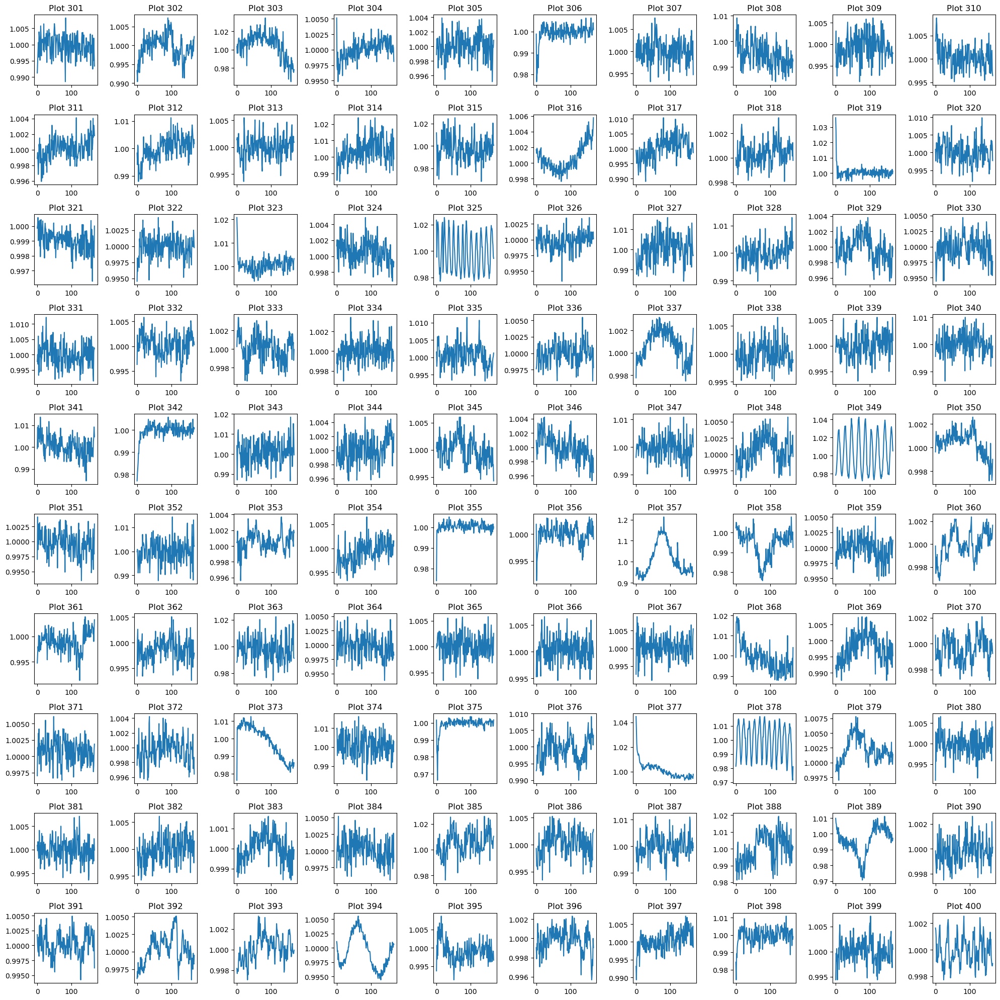

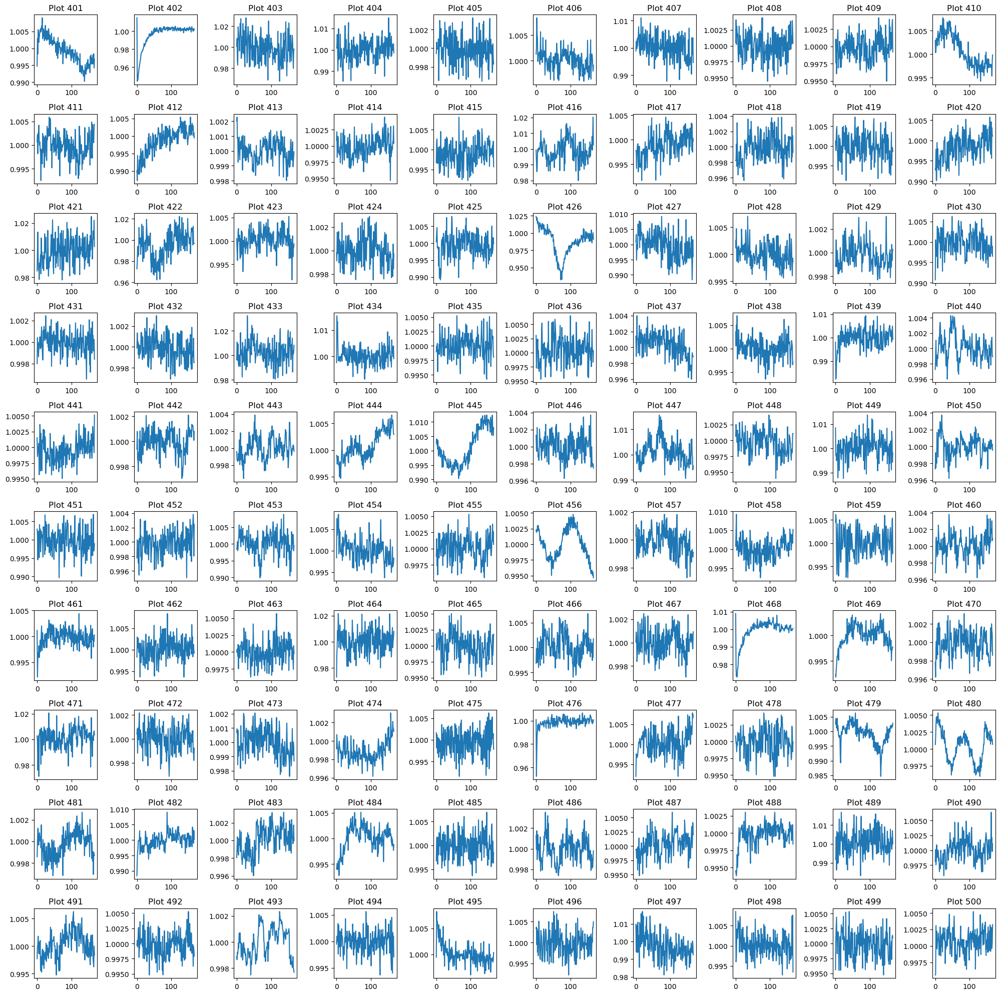

...

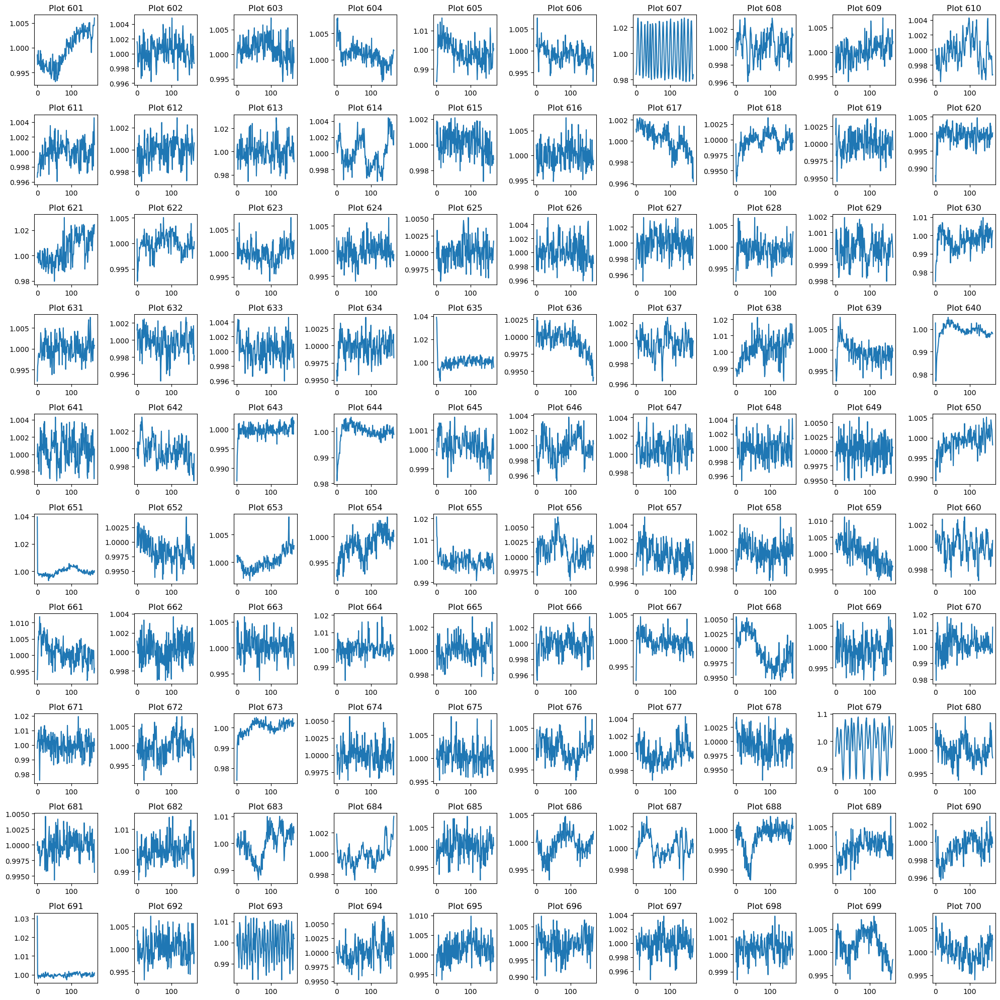

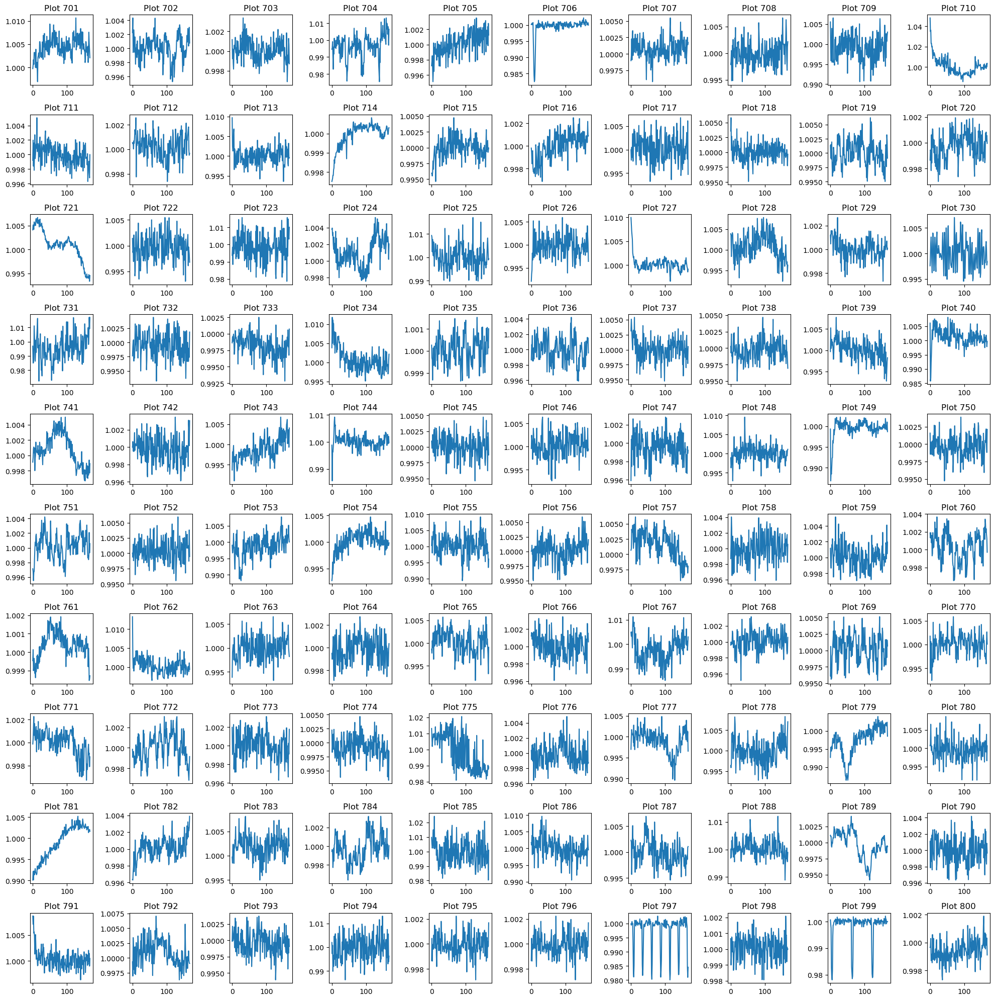

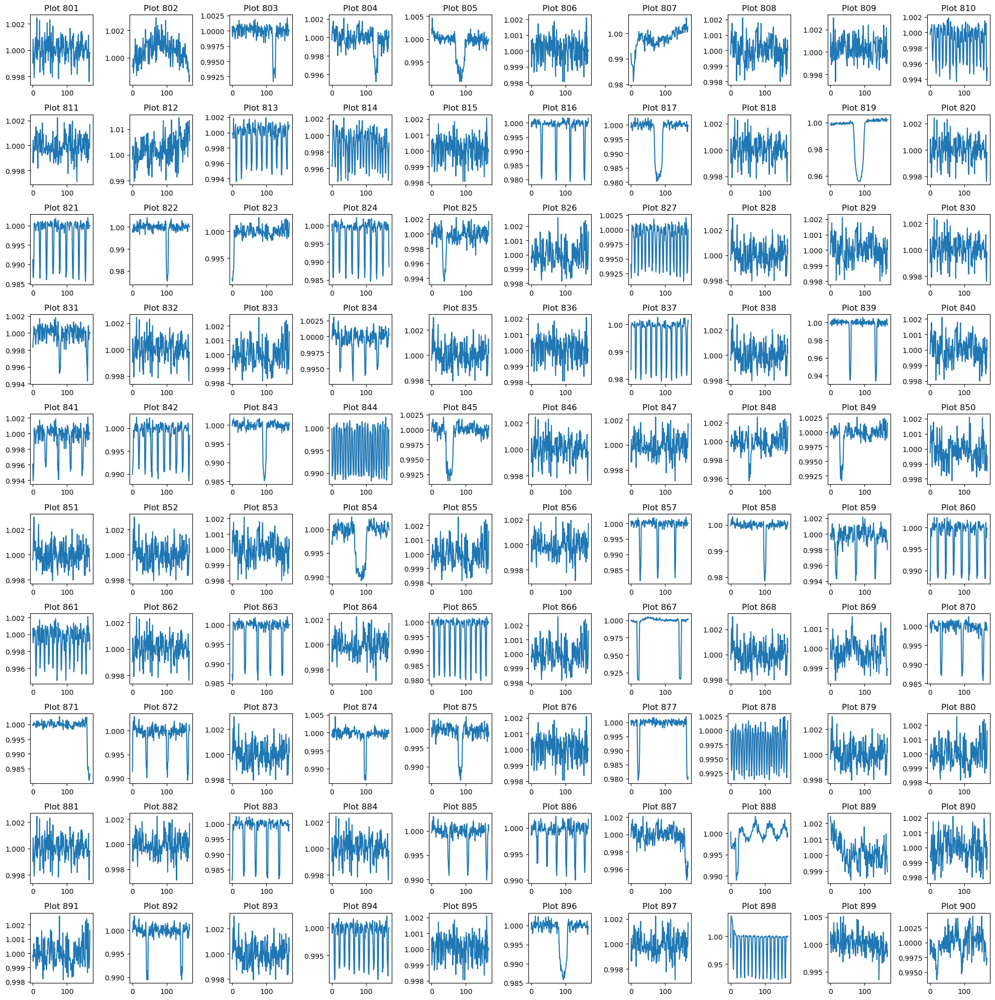

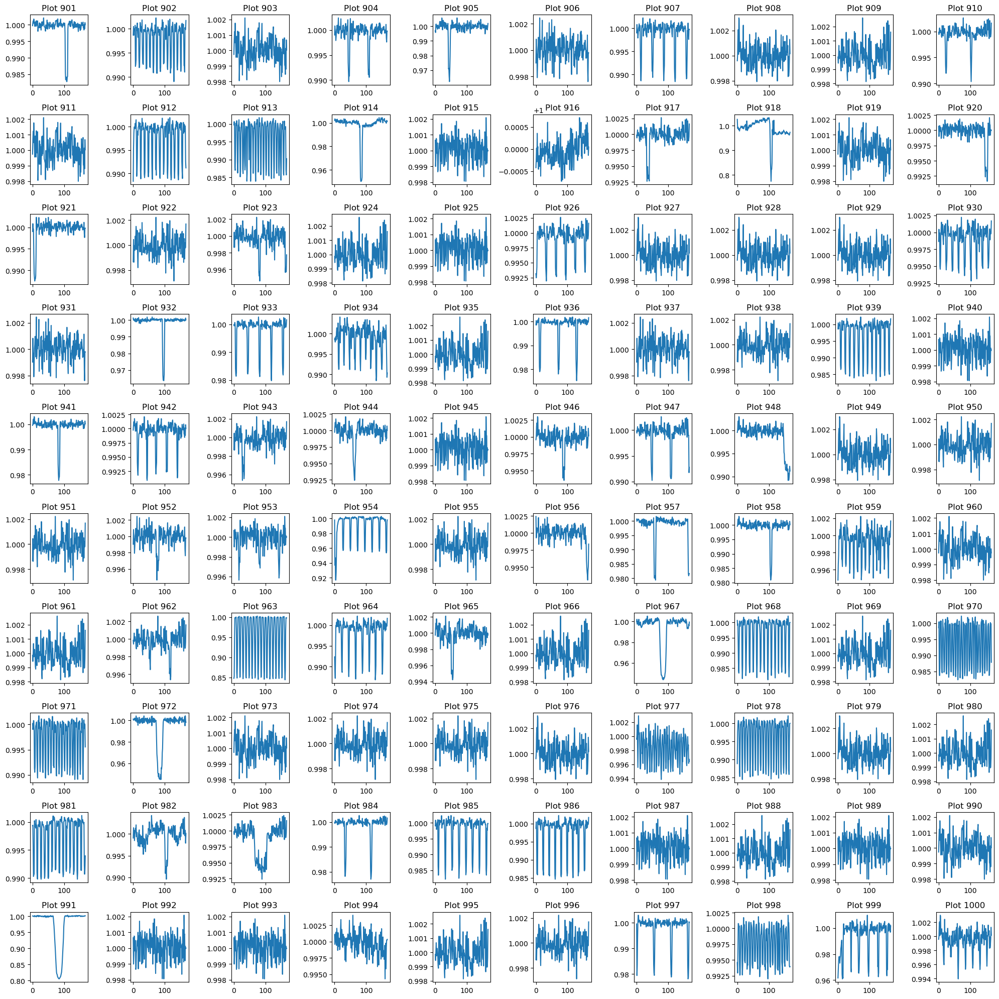

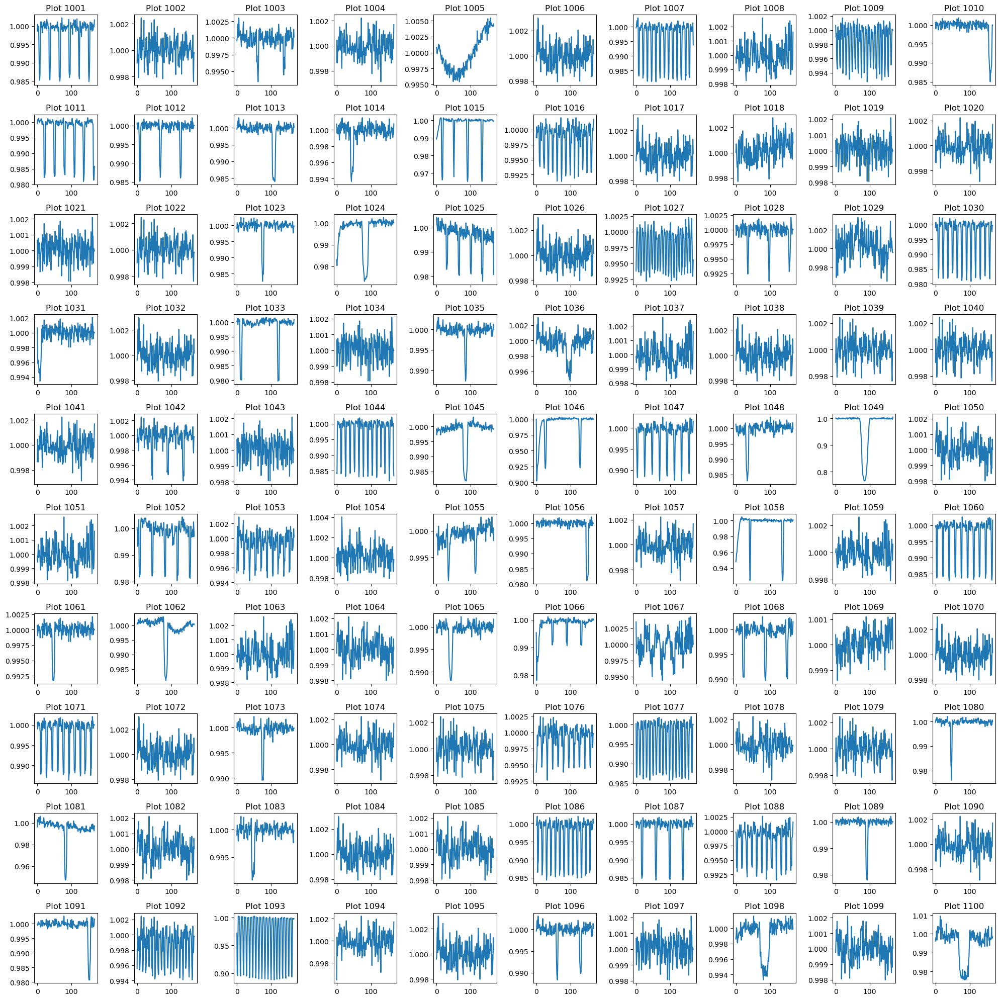

Exception ignored in: <bound method IPythonKernel._clean_thread_parent_frames of <ipykernel.ipkernel.IPythonKernel object at 0x112763910>>
Traceback (most recent call last):
  File "/Users/azib/micromamba/envs/nets2/lib/python3.8/site-packages/ipykernel/ipkernel.py", line 770, in _clean_thread_parent_frames
    def _clean_thread_parent_frames(
KeyboardInterrupt: 


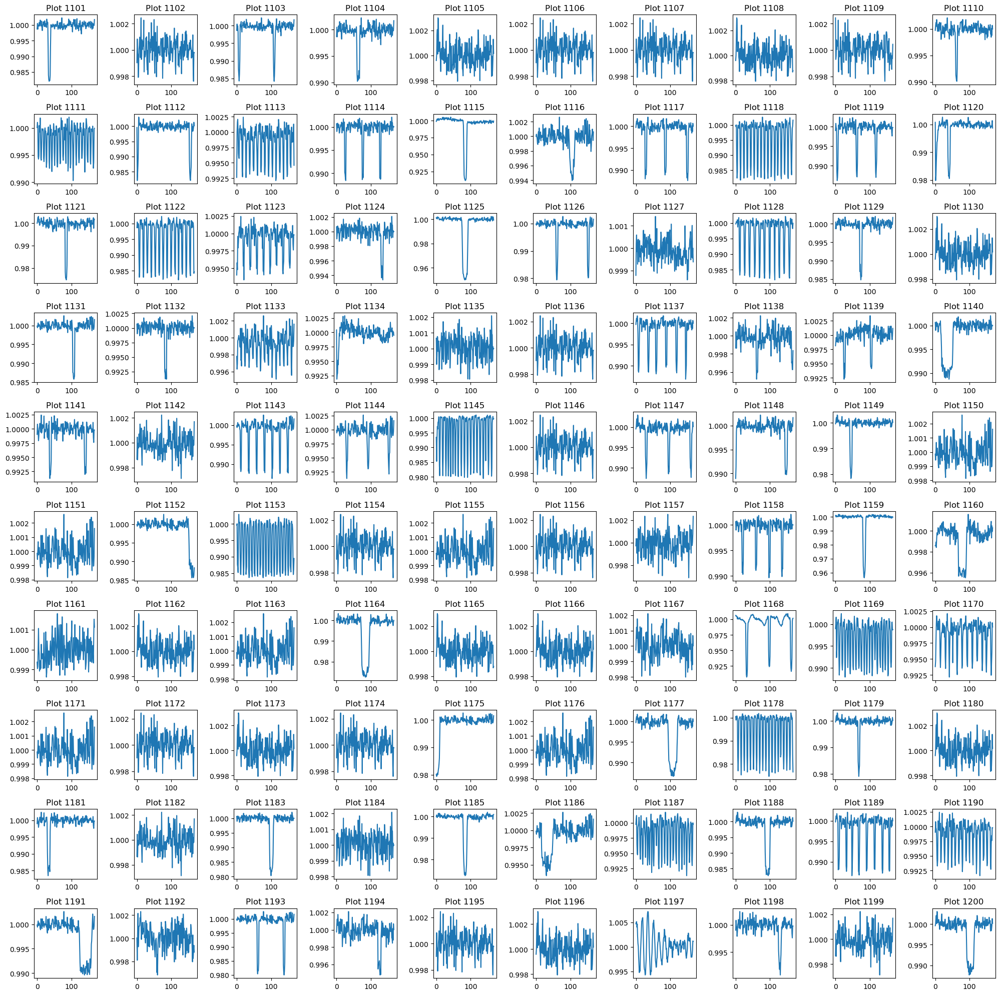

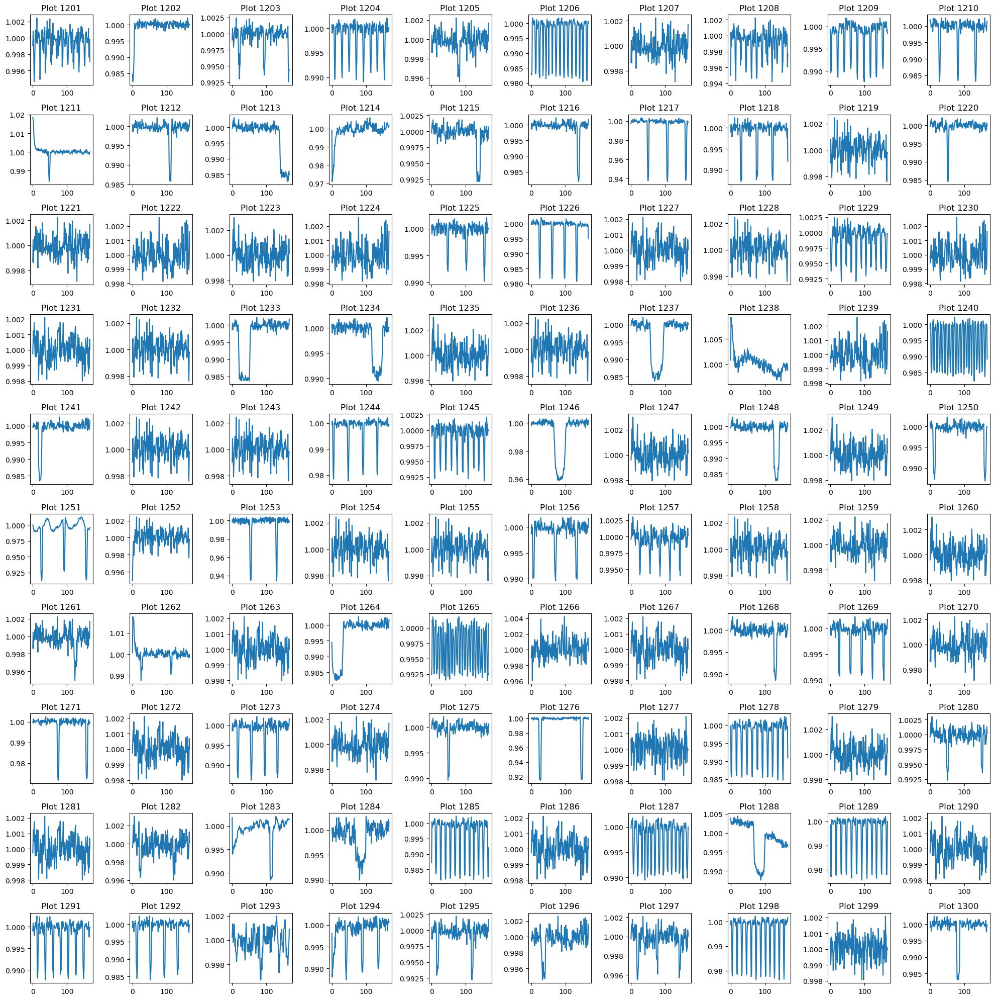

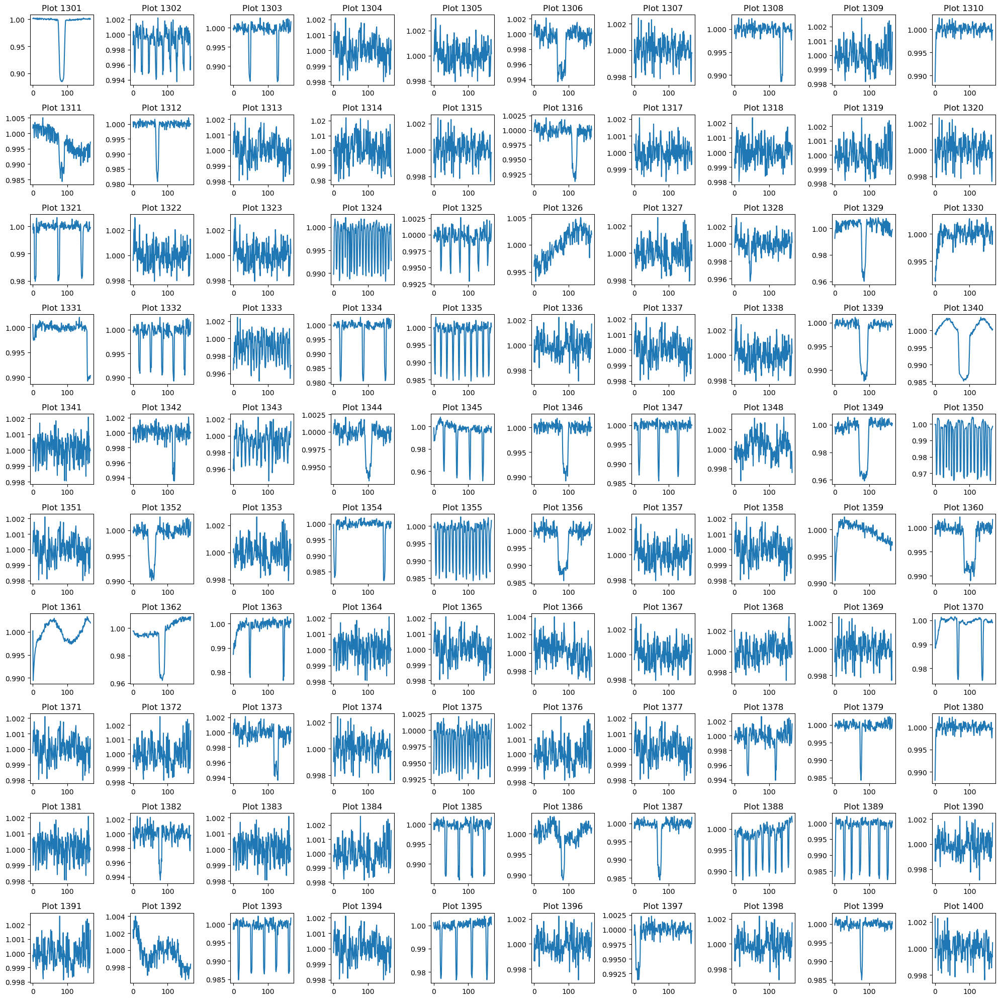

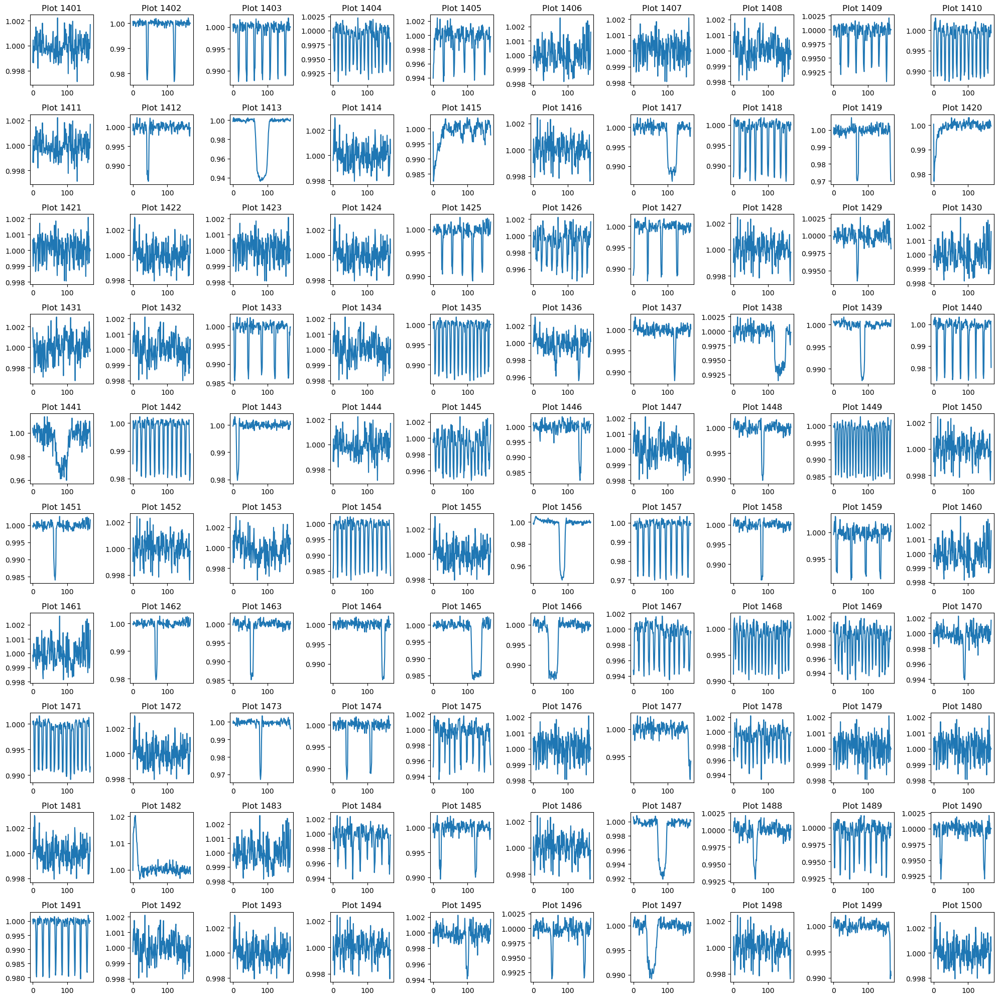

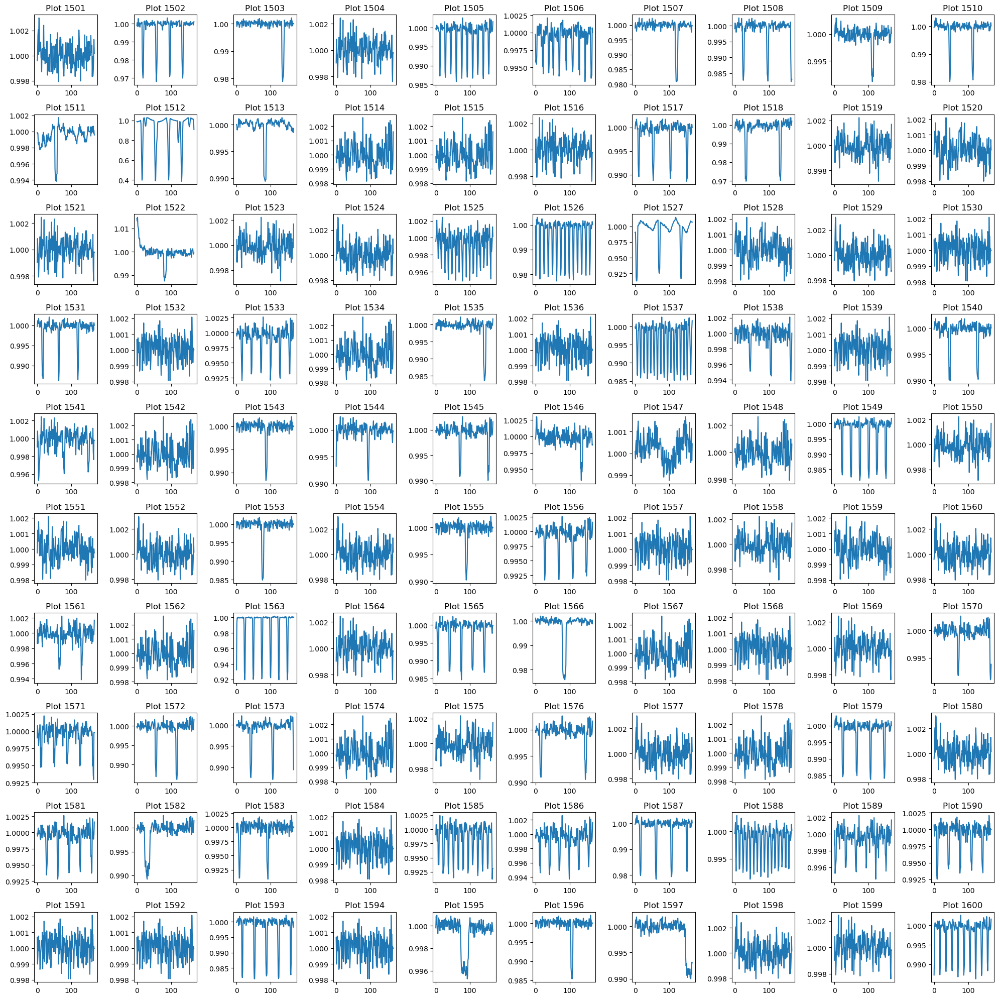

...

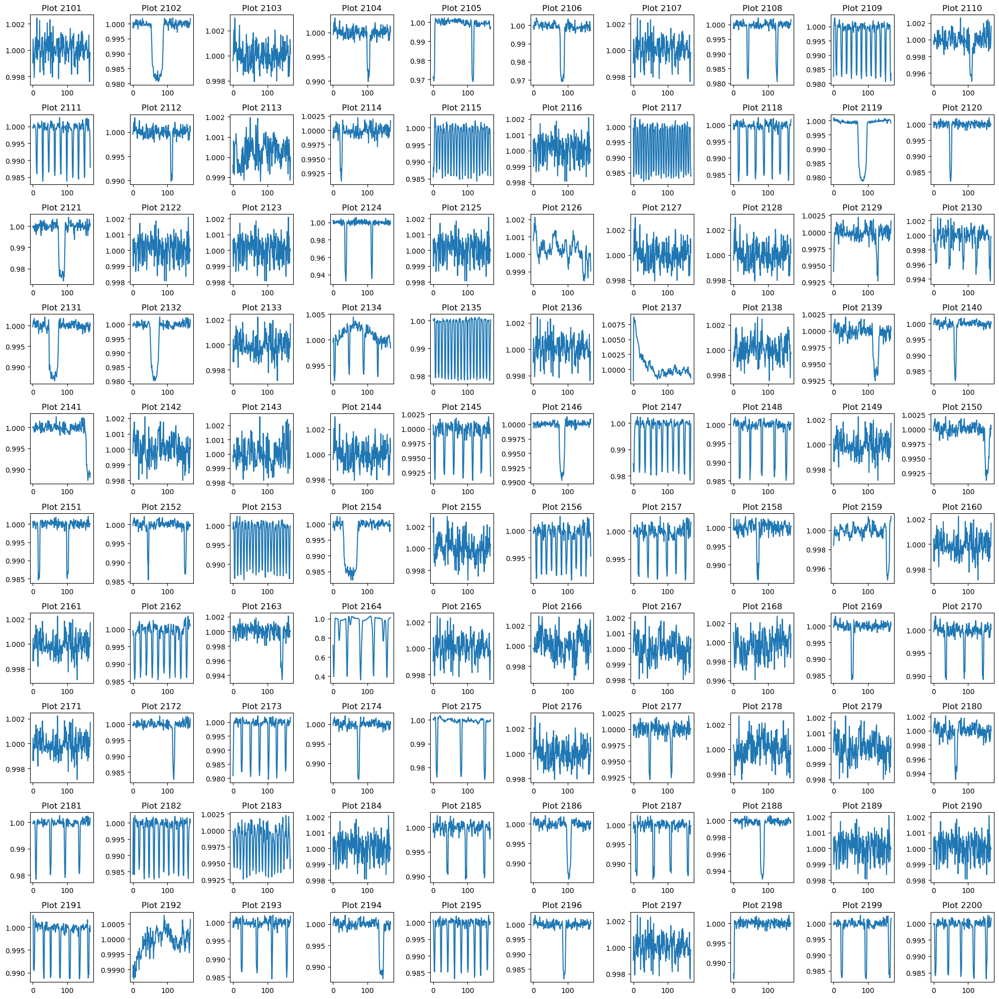

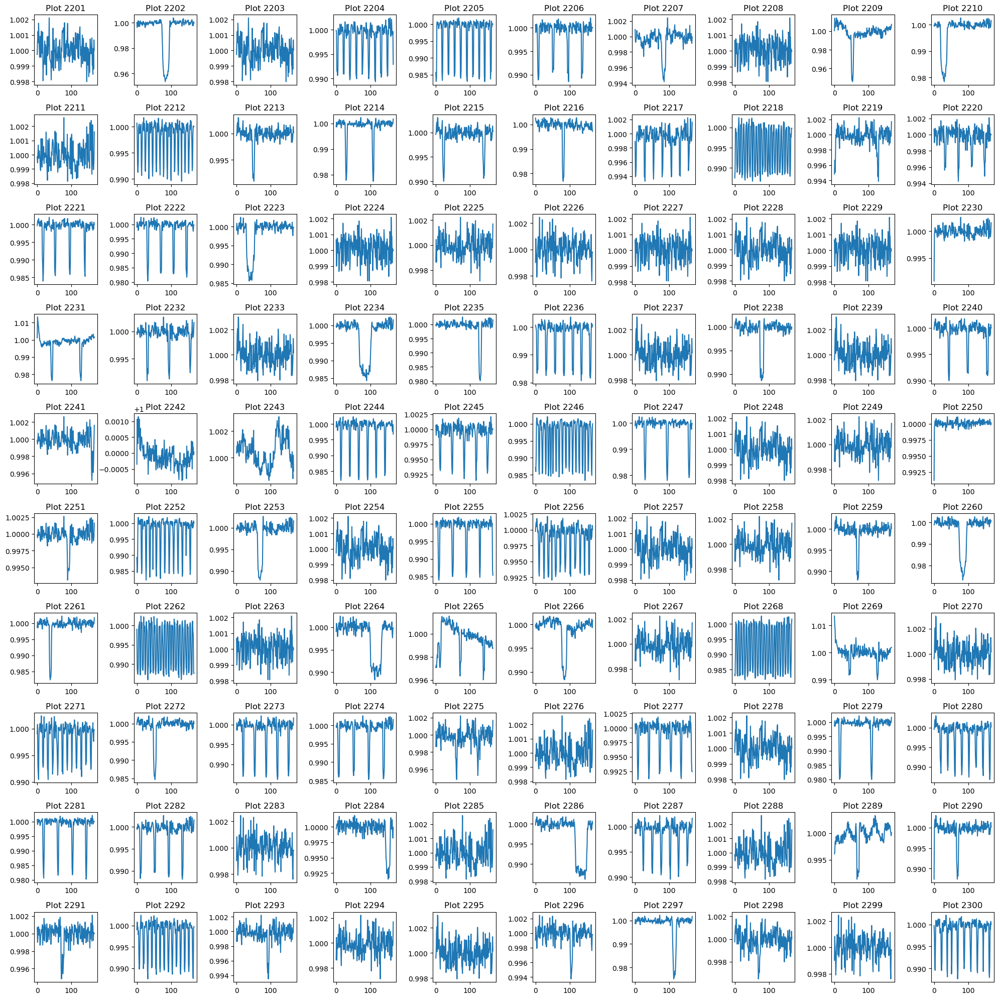

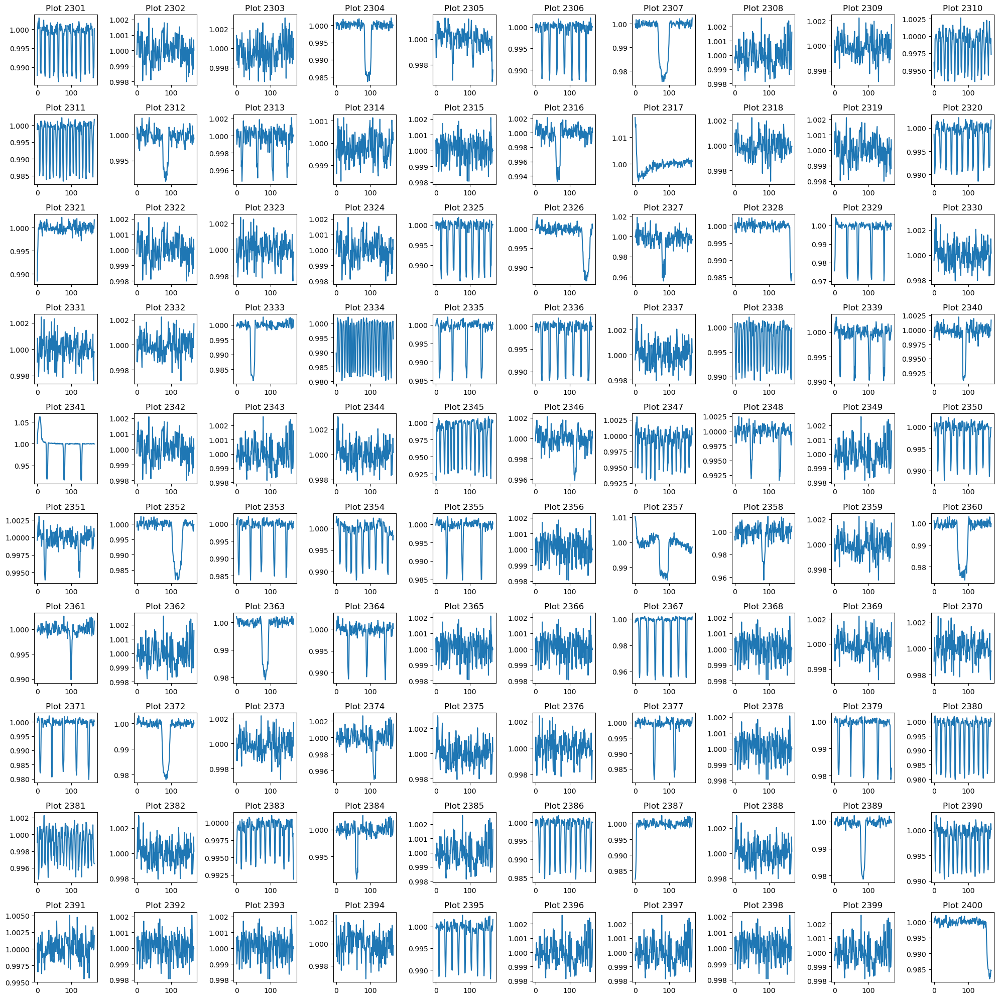

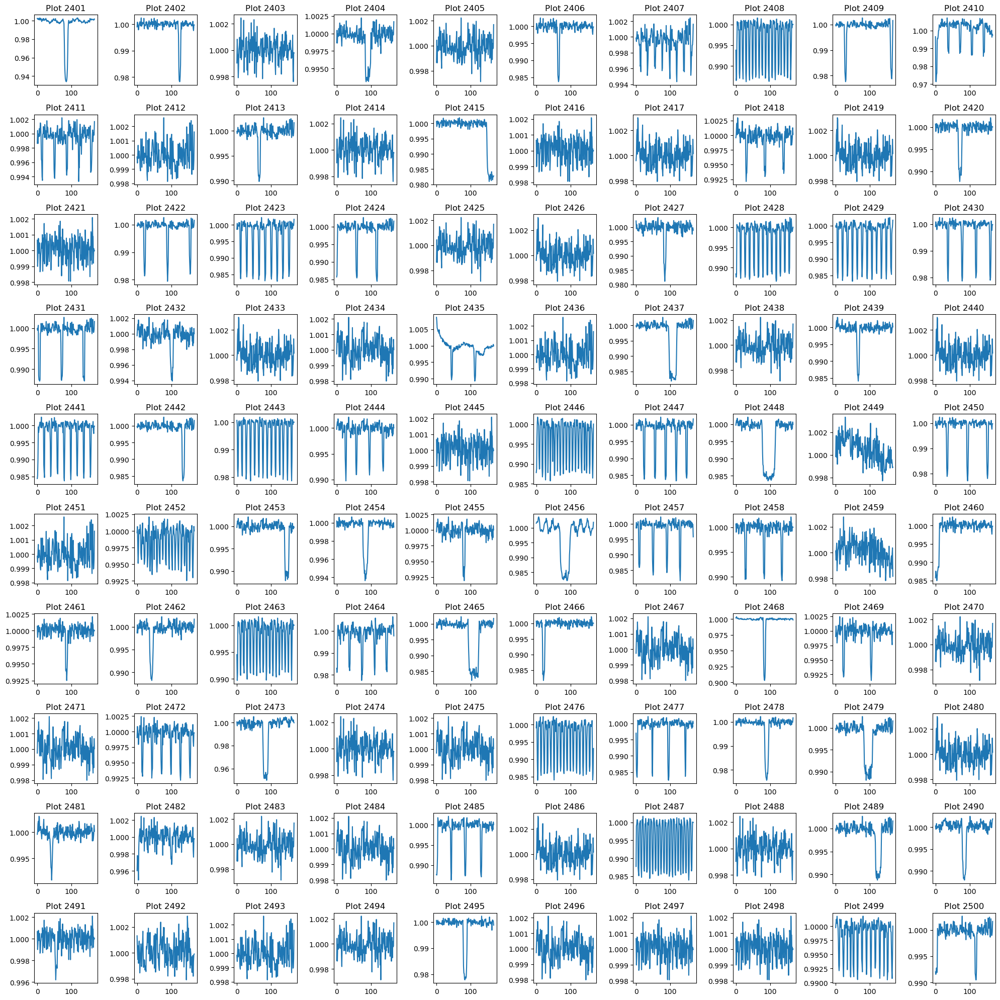

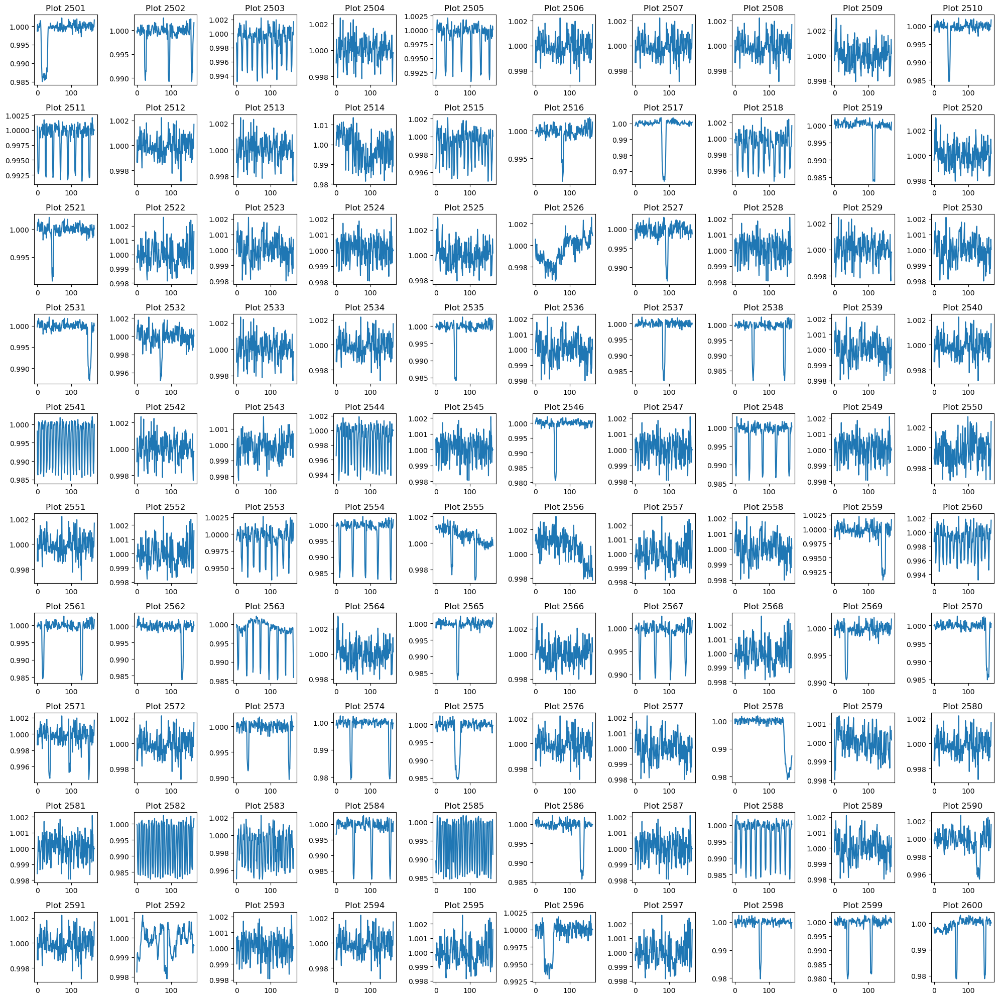

In [30]:
dsnomodels = ds2.train_data[ind_nc]
num_sets = dsnomodels.shape[0] // 100

for set_index in range(num_sets):
    start_index = set_index * 100
    end_index = min((set_index + 1) * 100, dsnomodels.shape[0])  # Ensure not to exceed the length of the data

    # Create a new 10x10 grid of subplots for each set
    fig, axs = plt.subplots(10, 10, figsize=(20, 20))

    # Flatten the axes array for easier iteration
    axs = axs.flatten()

    # Iterate over the elements in the current set and plot each in the grid
    for i in range(start_index, end_index):
        plot_index = i % 100  # Calculate the index within the current grid
        axs[plot_index].plot(dsnomodels[i, :, 0])  # Assuming you want to plot the first dimension of your array
        axs[plot_index].set_title(f"Plot {i+1}")  # Title for each subplot

    # Hide any remaining empty subplots
    for j in range(end_index - start_index, len(axs)):
        axs[j].axis('off')

    
    plt.tight_layout()  # Adjust layout
    #plt.savefig('exoplanet-models.png',dpi=200)
    plt.show()  # Show the grid of plots
    break

In [20]:
data_dict = {}

# Load each .npy file and store in the dictionary
for target_ID in ds.ids:
    filename = f"{folder2}/{target_ID}.npy"
    data = np.load(filename)
    data_dict[target_ID] = data

In [ ]:
{key: data_dict[key] for key in ds.train_data if key in b}

In [ ]:
num_sets = dsmodels.shape[0] // 100

for set_index in range(num_sets):
    start_index = set_index * 100
    end_index = min((set_index + 1) * 100, dsmodels.shape[0])  # Ensure not to exceed the length of the data

    # Create a new 10x10 grid of subplots for each set
    fig, axs = plt.subplots(10, 10, figsize=(20, 20))

    # Flatten the axes array for easier iteration
    axs = axs.flatten()

    # Iterate over the elements in the current set and plot each in the grid
    for i in range(start_index, end_index):
        plot_index = i % 100  # Calculate the index within the current grid
        axs[plot_index].plot(dsmodels[i, :, 0])  # Assuming you want to plot the first dimension of your array
        axs[plot_index].set_title(f"Plot {i+1}")  # Title for each subplot

    # Hide any remaining empty subplots
    for j in range(end_index - start_index, len(axs)):
        axs[j].axis('off')

    
    plt.tight_layout()  # Adjust layout
    plt.savefig('exoplanet-models.png',dpi=200)
    plt.show()  # Show the grid of plots
    break